## Societyデータを大阪府の地図にマッピング
Societyで以前マッピングに利用したデータを使ってマッピングできたので、他の項目も追加したcsvを可視化してみることにした。</br>
https://soan.jp/plotly

In [40]:
import json
import re
import pandas as pd
import plotly.express as px
import geocoder as geocoder

# 定数
PREFECTURE = "大阪府"
CSV_FILE = "./data/area_mappingdata.csv"
GEOJSON_FILE = "./data/N03-20_27_200101.geojson"
MAPBOX_STYLE = "carto-positron"
COLOR_RANGE = (40, 75)
COLOR_SET = "気分_合計スコア"
ZOOM_LEVEL = 8
OPACITY = 0.5
FIG_SIZE = 800

#color_mapping = {
#    "1": "red",    
#    "2": "green",  
#    "3": "blue",
#    "4": "yellow"
#}

In [41]:
def load_data(CSV_FILE, geojson_file):
    """CSVファイルとGeoJSONファイルからデータフレームとGeoJSONを作成する"""
    # XLSファイルから人口データフレーム作成
    df = pd.read_csv(CSV_FILE, header=0)
    #大阪府のみ抽出
    #df = df[df['area'].str.startswith('27')]
    # クラスを数値型に変換する
    #df[['clus']] = df[['clus']].replace(',', '', regex=True).astype('float')

    # GeoJSONファイルから地図データ読み込み
    with open(geojson_file) as f:
        geojson = json.load(f)
        # GeoJSONデータから不要な列を削除する
        for feature in geojson['features']:
            feature['properties'].pop('N03_001')
            feature['properties'].pop('N03_002')
            feature['properties'].pop('N03_003')
            feature['properties'].pop('N03_004')

    return df, geojson

def plot_map(df, geojson, prefecture):
    """データフレームとGeoJSONから地図をプロットする"""
    # 都道府県の中心座標を取得
    center_latlng = geocoder.arcgis(prefecture).latlng

    # コロプレスマップを描画
    fig = px.choropleth_mapbox(
        df,
        geojson=geojson,
        locations="area",
        color=COLOR_SET,
#        color_discrete_map=color_mapping,  # 色を固定値で指定
#        hover_name="育児困難感_自責感",
#       hover_data=['人口','クラスター', '育児困難感_自責感'],
        featureidkey="properties.N03_007",
        mapbox_style=MAPBOX_STYLE,
        range_color=COLOR_RANGE,
        zoom=ZOOM_LEVEL,
        center={"lat": center_latlng[0]-0.5, "lon": center_latlng[1]},
        opacity=OPACITY,
        width=FIG_SIZE,
        height=FIG_SIZE,
    )
    fig.update_layout(margin=dict(b=0, t=0, l=0, r=0))
    fig.show()

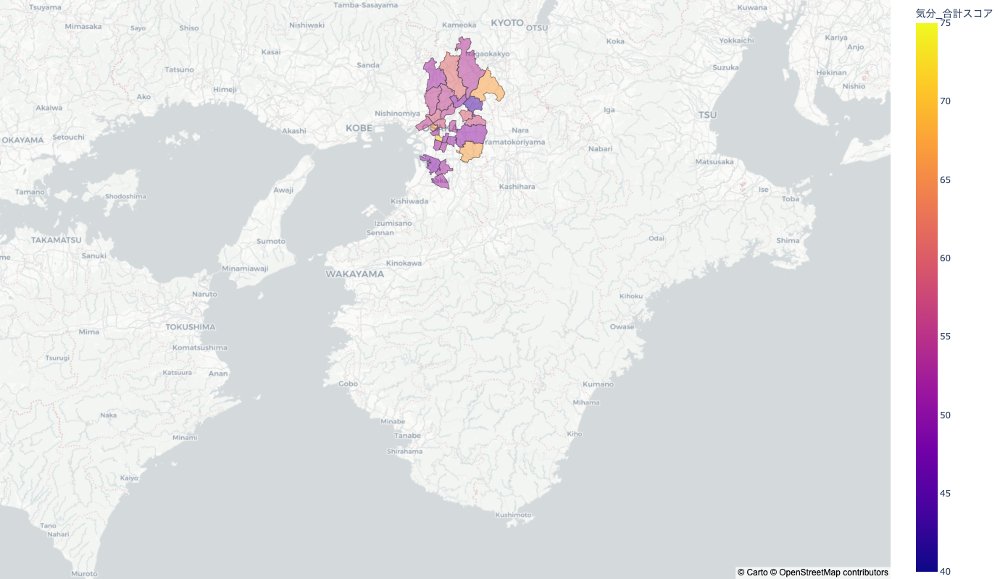

In [42]:
# メイン処理
if __name__ == "__main__":
    df_osaka, geojson_osaka = load_data(CSV_FILE, GEOJSON_FILE)
    plot_map(df_osaka, geojson_osaka, PREFECTURE)

In [15]:
df_osaka.columns

Index(['Unnamed: 0', 'area', 'A_可住地面積１k.当たり人口密度', 'A_昼夜間人口比率',
       'A_外国人人口.人口１０万人当たり.', 'A_１５歳未満人口割合', 'A_１５.６４歳人口割合', 'A_６５歳以上人口割合',
       'A_未婚者割合.15歳以上人口.', 'A_人口増減率', 'A_転入超過率', 'A_転入率', 'A_転出率', 'A_核家族世帯割合',
       'A_高齢夫婦のみの世帯の割合', 'A_高齢単身世帯の割合', 'B_総面積.都道府県面積に占める割合.', 'B_可住地面積割合',
       'C_商業年間商品販売額.卸売業.小売業..従業者１人当たり.', 'C_商業年間商品販売額.卸売業.小売業..事業所当たり.',
       'E_小学校数.可住地面積100k.当たり.', 'E_中学校数.可住地面積100k.当たり.',
       'E_高等学校数.可住地面積100k.当たり.', 'F_就業者比率', 'F_第１次産業就業者比率.対就業者.',
       'F_第２次産業就業者比率.対就業者.', 'F_第３次産業就業者比率.対就業者.', 'F_第２次産業及び第３次産業就業者比率.対就業者.',
       'F_完全失業率', 'F_他市区町村への通勤者比率', 'F_他市区町村からの通勤者比率', 'F_高齢就業者割合.６５歳以上.',
       'G_公民館数.人口100万人当たり.', 'G_図書館数.人口100万人当たり.', 'H_小売店数.人口千人当たり.',
       'H_飲食店数.人口千人当たり.', 'H_大型小売店数.人口10万人当たり.', 'H_百貨店.総合スーパー数.人口10万人当たり.',
       'I_一般病院数.人口10万人当たり.', 'I_一般診療所数.人口10万人当たり.',
       'J_介護老人福祉施設.65歳以上人口10万人当たり.', '都市コード', 'クラスター', '人口', '世帯数', '出生児数',
       '年齢', '出産回数', '子人数', '周産期うつ傾向', 'Time', '気分_怒り～敵意', '気分_混乱～当惑',
       '気

In [9]:
df_osaka.describe() 

,Unnamed: 0,area,A_可住地面積１k.当たり人口密度,A_昼夜間人口比率,A_外国人人口.人口１０万人当たり.,A_１５歳未満人口割合,A_１５.６４歳人口割合,A_６５歳以上人口割合,A_未婚者割合.15歳以上人口.,A_人口増減率,...,育児困難感_感情コントロール,育児困難感_システム化衝動,育児困難感_同時・全体処理,育児困難感_同調困難,育児困難感_愛着の問題,育児困難感_自信のなさ,育児困難感_対処可能性,育児困難感_子供への愛着,育児困難感_自己肯定感,育児困難感_自責感
count,1868.00000,1868.000000,1868.000000,1868.000000,1868.000000,1868.000000,1868.000000,1868.000000,1868.000000,1868.000000,...,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000
mean,934.50000,21159.457173,1902.214133,98.408030,977.208084,11.875329,56.398045,31.186615,24.333170,-4.126435,...,2.181592,2.967040,2.590174,1.958955,1.582090,2.406716,2.791045,1.345771,2.093284,1.894279
std,539.38947,14013.263564,3275.007115,38.408581,1130.436034,2.316602,5.275976,7.186089,4.122530,5.734231,...,0.602311,0.689841,0.668188,0.639746,0.937829,0.892770,0.728995,0.726085,0.669741,0.796117
min,1.00000,1101.000000,10.500000,68.600000,0.000000,0.308000,35.165000,12.674000,12.989590,-87.340000,...,1.000000,1.750000,1.250000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,467.75000,9214.750000,267.675000,89.500000,378.675000,10.499250,53.134250,25.944750,21.554047,-7.510000,...,1.750000,2.500000,2.000000,1.562500,1.000000,1.812500,2.250000,1.000000,1.625000,1.250000
50%,934.50000,20447.000000,562.100000,96.400000,659.250000,11.900500,56.857000,30.465000,24.083290,-4.180000,...,2.250000,2.875000,2.500000,2.000000,1.000000,2.250000,2.750000,1.000000,2.000000,1.750000
75%,1401.25000,32202.250000,1670.550000,101.125000,1176.625000,13.272500,60.104250,35.859750,26.610230,-0.570000,...,2.500000,3.375000,3.000000,2.250000,1.750000,2.937500,3.250000,1.333333,2.500000,2.250000
max,1868.00000,47382.000000,22380.200000,1460.600000,15758.600000,21.070000,76.000000,60.485000,45.326720,23.960000,...,4.000000,4.750000,4.000000,5.000000,5.000000,5.000000,5.000000,5.000000,4.000000,4.666667


In [ ]:
#describeの代わりに、ydata-profilingで変数毎の傾向を見る
import pandas as pd
from ydata_profiling import ProfileReport
df = pd.read_csv('./data/area_mappingdata.csv')
profile = ProfileReport(df, title="Profiling Report")
profile.to_notebook_iframe()
profile.to_file("mappingdata_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### <font color=red>処理が重かったのか、エラー（エラーコード5）HTMLファイルは保存できたが、表示すると同様のエラー（エラーコード5）</font>

In [ ]:
df_LINE = pd.read_csv('./data/Judan_LINE_short.csv')
profile = ProfileReport(df_LINE, title="LINE Profiling Report")
profile.to_notebook_iframe()
profile.to_file("LINE_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

### <font color=red>LINEデータでも同様のエラー（エラーコード5）</font>

In [45]:
df_Yachin = pd.read_csv('./data/Yachin_sikuchoson.csv')
profile = ProfileReport(df_Yachin, title="Yachin Report")
profile.to_notebook_iframe()
profile.to_file("Yachin_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### <font color=blue>列数の少ない家賃データはProfilingできた（ただしグラフ内に日本語の文字化けあり、、、）</font>

In [38]:
# 文字化けの検証：pandas_profilingで可視化してみた結果はy-dataと同じ見た目だった。（インストールしているのがy-dataなのでどちらのコードでも同じ結果になる？エラーコード5の原因はメモリ不足？）
import pandas_profiling as pdp
pdp.ProfileReport(df_Yachin)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [37]:
#エラーが出た最初のcsvで, 処理を軽くするために、minimal=Trueを設定したら、エラーが出ずに出力された！！
import pandas as pd
from ydata_profiling import ProfileReport
df = pd.read_csv('./data/area_mappingdata.csv')
profile = ProfileReport(df, title="Profiling Report", minimal=True)
profile.to_notebook_iframe()
profile.to_file("mappingdata_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# 以下plotlyの地図マッピングテストに戻る

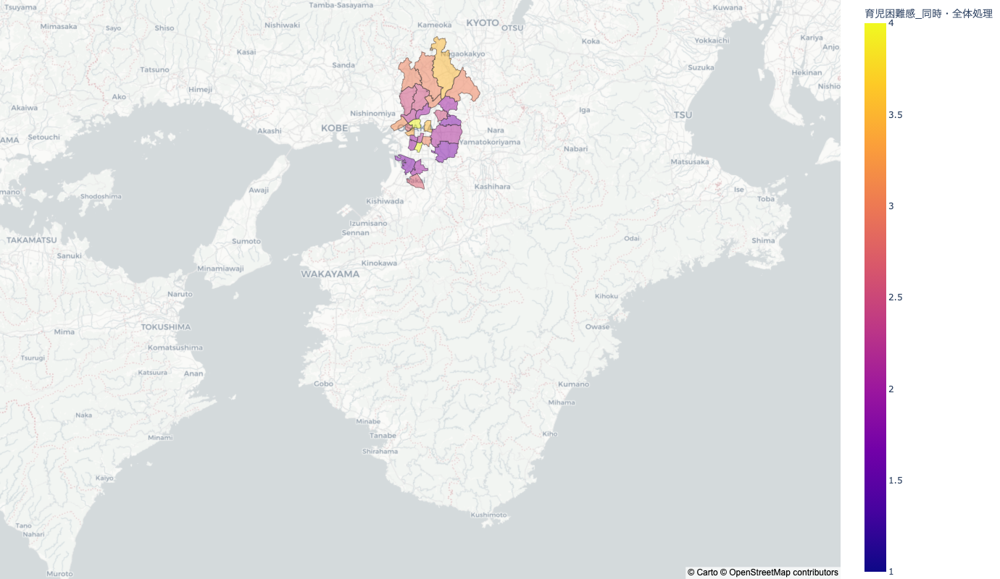

In [46]:
#マッピングデータ再設定
COLOR_RANGE = (1, 4)
COLOR_SET = "育児困難感_同時・全体処理"
#メイン処理
if __name__ == "__main__":
    df_osaka, geojson_osaka = load_data(CSV_FILE, GEOJSON_FILE)
    plot_map(df_osaka, geojson_osaka, PREFECTURE)

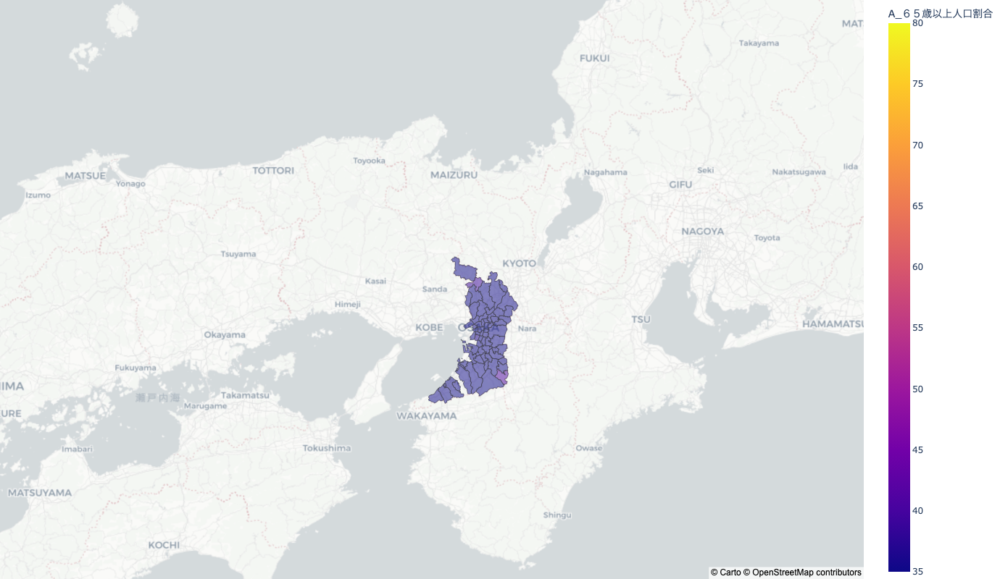

In [13]:
#マッピングデータ再設定
COLOR_RANGE = (35, 80)
COLOR_SET = "A_６５歳以上人口割合"
#メイン処理
if __name__ == "__main__":
    df_osaka, geojson_osaka = load_data(CSV_FILE, GEOJSON_FILE)
    plot_map(df_osaka, geojson_osaka, PREFECTURE)